<a href="https://colab.research.google.com/github/vramey2/Butterfly_Classification/blob/main/Butterfly_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!unzip -u  "/content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/butterflies.zip" -d "/content/drive/MyDrive/Colab Notebooks/Butterfly_Classification"

Archive:  /content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/butterflies.zip


In [1]:
#import necessary libraries

In [1]:
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
from IPython.display import Image
import os
from pandas.core.common import random_state
from sklearn.model_selection import train_test_split
from matplotlib.pyplot import imread
import plotly.express as px

In [4]:
#read files for training set labels
Training_set_csv = pd.read_csv("drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/Training_set.csv")

In [5]:
#Look into description of the file, check how many labels there are
print (Training_set_csv.describe())
print (Training_set_csv.head())
index = Training_set_csv["label"].value_counts()
index

           filename           label
count          6499            6499
unique         6499              75
top     Image_1.jpg  MOURNING CLOAK
freq              1             131
      filename                     label
0  Image_1.jpg          SOUTHERN DOGFACE
1  Image_2.jpg                    ADONIS
2  Image_3.jpg            BROWN SIPROETA
3  Image_4.jpg                   MONARCH
4  Image_5.jpg  GREEN CELLED CATTLEHEART


MOURNING CLOAK    131
SLEEPY ORANGE     107
ATALA             100
BROWN SIPROETA     99
CRECENT            97
                 ... 
AMERICAN SNOOT     74
GOLD BANDED        73
MALACHITE          73
CRIMSON PATCH      72
WOOD SATYR         71
Name: label, Length: 75, dtype: int64

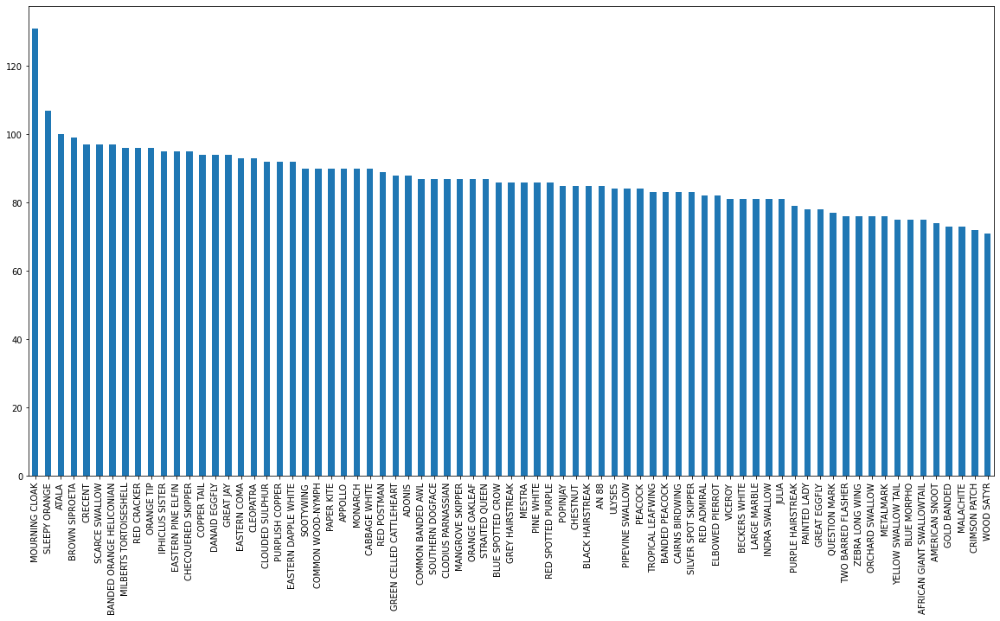

In [6]:
# Plot a barchart to see how many images are there for each label 
Training_set_csv["label"].value_counts().plot.bar(figsize = (20, 10))

In [7]:
# Visualize counts of images for different species as a pie chart
values = Training_set_csv["label"].value_counts()

fig = px.pie(pd.read_csv("drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/Training_set.csv"), values=values, names= index,
             title='Piechart of Species')
fig.update_traces(textposition='inside', textinfo='percent')
fig.show()

In [8]:
#check what is the median number of images in eah label.
Training_set_csv["label"].value_counts().median()

86.0

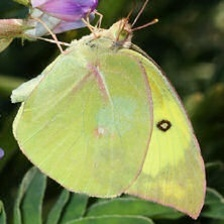

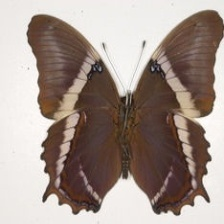

In [9]:
#Display couple images from training set
display (Image ("drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_1.jpg"))
display (Image("drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_3.jpg"))

In [10]:
#create names of the files for training using csv file and display 5 first names
filenames = ["drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/" + fname for fname
             in Training_set_csv["filename"]]
filenames [:5]

['drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_1.jpg',
 'drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_2.jpg',
 'drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_3.jpg',
 'drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_4.jpg',
 'drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/train/Image_5.jpg']

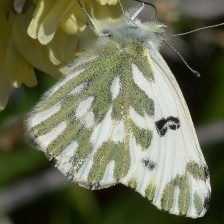

In [11]:
#Display an image using file names
Image (filenames[100])

In [12]:
#Create an array for names of species from training csv file
species = Training_set_csv["label"]
species = np.array(species)
species

array(['SOUTHERN DOGFACE', 'ADONIS', 'BROWN SIPROETA', ..., 'APPOLLO',
       'ELBOWED PIERROT', 'ATALA'], dtype=object)

In [13]:
#Check how many unique species of butterflies are there for training
unique_species = np.unique(species)
 
len(unique_species)

75

In [14]:
#print out the unique species
unique_species

array(['ADONIS', 'AFRICAN GIANT SWALLOWTAIL', 'AMERICAN SNOOT', 'AN 88',
       'APPOLLO', 'ATALA', 'BANDED ORANGE HELICONIAN', 'BANDED PEACOCK',
       'BECKERS WHITE', 'BLACK HAIRSTREAK', 'BLUE MORPHO',
       'BLUE SPOTTED CROW', 'BROWN SIPROETA', 'CABBAGE WHITE',
       'CAIRNS BIRDWING', 'CHECQUERED SKIPPER', 'CHESTNUT', 'CLEOPATRA',
       'CLODIUS PARNASSIAN', 'CLOUDED SULPHUR', 'COMMON BANDED AWL',
       'COMMON WOOD-NYMPH', 'COPPER TAIL', 'CRECENT', 'CRIMSON PATCH',
       'DANAID EGGFLY', 'EASTERN COMA', 'EASTERN DAPPLE WHITE',
       'EASTERN PINE ELFIN', 'ELBOWED PIERROT', 'GOLD BANDED',
       'GREAT EGGFLY', 'GREAT JAY', 'GREEN CELLED CATTLEHEART',
       'GREY HAIRSTREAK', 'INDRA SWALLOW', 'IPHICLUS SISTER', 'JULIA',
       'LARGE MARBLE', 'MALACHITE', 'MANGROVE SKIPPER', 'MESTRA',
       'METALMARK', 'MILBERTS TORTOISESHELL', 'MONARCH', 'MOURNING CLOAK',
       'ORANGE OAKLEAF', 'ORANGE TIP', 'ORCHARD SWALLOW', 'PAINTED LADY',
       'PAPER KITE', 'PEACOCK', 'PINE WHIT

In [15]:
# Convert labels into boolean array
boolean_species = [label == unique_species for label in species]

In [16]:
#set up x and y variables
x = filenames
y = boolean_species

In [17]:
#split data for training and validation
x_train, x_val, y_train, y_val = train_test_split(x[:2000], y[:2000], test_size = 0.2, random_state = 42)
len (x_train), len(y_train), len (x_val), len (y_val)

(1600, 1600, 400, 400)

In [18]:
#turn image path  into tensors for the model
IMAGE_SIZE = 224
#PROCESS IMAGE

def image_processing (image_path, imgsize = IMAGE_SIZE):
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels = 3)
  image = tf.image.convert_image_dtype (image, tf.float32)
  image = tf.image.resize(image, size = [IMAGE_SIZE, IMAGE_SIZE])
  return image

In [19]:
#return tuple of tensors (image and label)
def getlabel_image (image_path, label):
  image = image_processing (image_path)
  return image, label

In [20]:

#turn data into batches. The batch size will be 35, use images (x) and labels (y) to create batches of data. 
def turn_to_batch (x, y= None, batch_size = 35, valid_data=False, test_data=False):
  if test_data:
    print ("Turning test data to batch...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) #only filepaths (no labels)
    my_batch = data.map(image_processing).batch(batch_size)
    return my_batch

  # Do not shuffle data if it is validation set
  elif valid_data: 
    print ("Turning validation data to batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant (x), tf.constant (y))) 
    my_batch = data.map(getlabel_image).batch(batch_size)
    return my_batch
  
  else:
    print ("Turning training data to batches batches")
    #  file paths and labels turned into tenses
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), tf.constant(y)))
    data = data.shuffle(buffer_size = len(x))  #shuffle data for training batch
    #create tuples of image and lebel 
    data = data.map(getlabel_image)

    #turn training data into batches
    my_batch = data.batch(batch_size)
    return my_batch

In [21]:
#create training and validation data batches
train_data = turn_to_batch (x_train, y_train)
val_data = turn_to_batch (x_val, y_val, valid_data = True)

Turning training data to batches batches
Turning validation data to batches...


In [22]:
# Visualize training images from the batch by converting batch elements to numpy and iterating over
train_images, train_labels = next(train_data.as_numpy_iterator())
len (train_images), len(train_labels)

(35, 35)

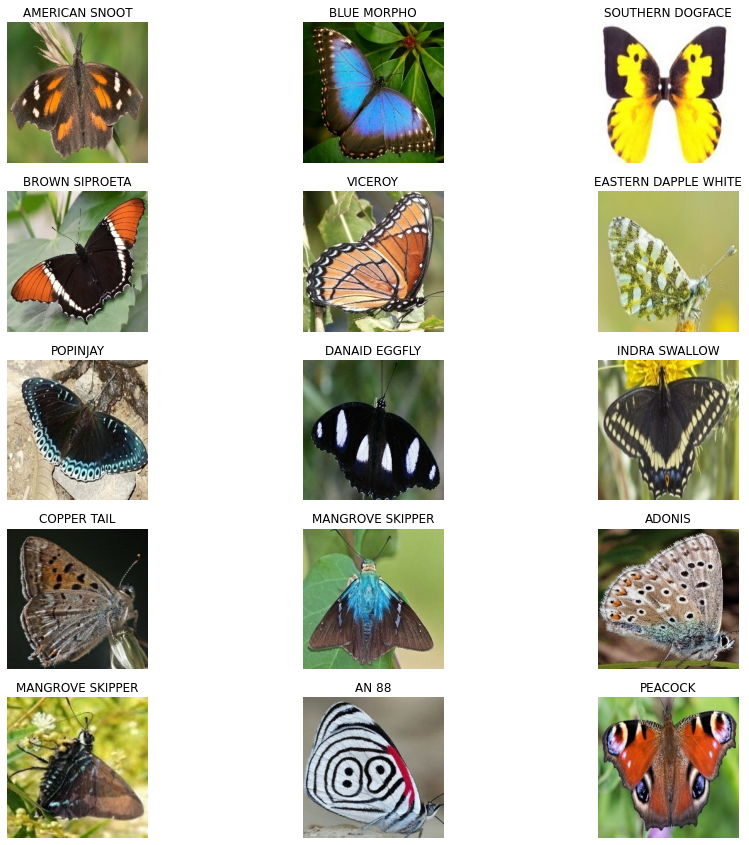

In [23]:
# Visualize some images from training set
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))
for i in range (15):
  ax=plt.subplot(5, 3, i+1)
  plt.imshow(train_images[i])
  plt.title(unique_species[train_labels[i].argmax()])
  plt.axis("off")

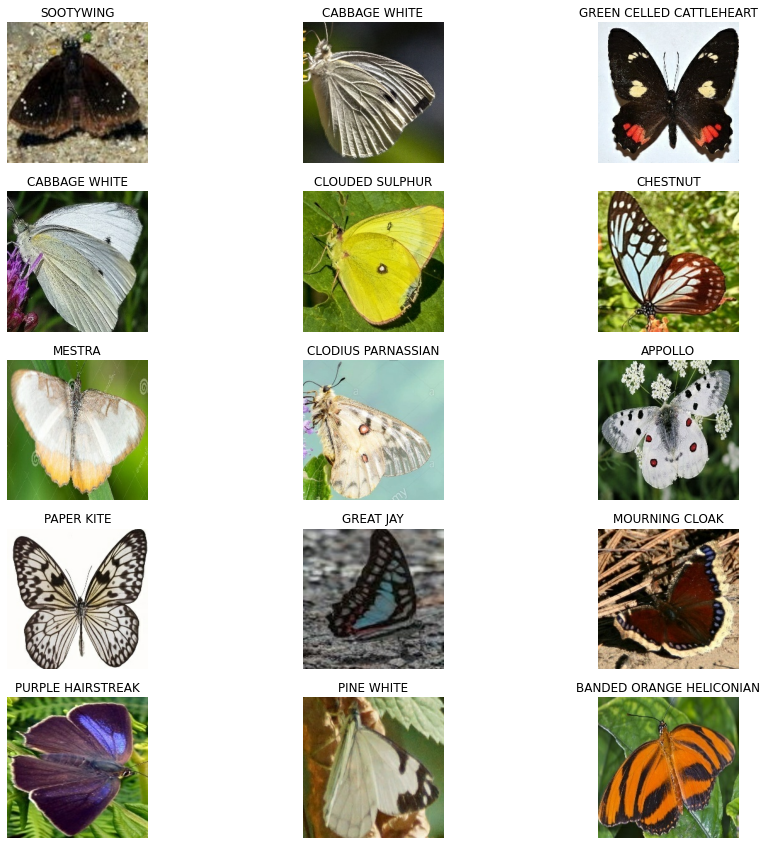

In [24]:
#now visualize validation set
val_images, val_labels = next(val_data.as_numpy_iterator())
plt.figure(figsize = (15, 15))
for i in range (15):
  ax=plt.subplot(5, 3, i+1)
  plt.imshow(val_images[i])
  plt.title(unique_species[val_labels[i].argmax()])
  plt.axis("off")
 

In [25]:
##building a model
# Defining input shap of the model (tensor images) and output shape, which is tensor form image labels.  

#set up input shape of the model
INPUT_MODEL = [None, IMAGE_SIZE, IMAGE_SIZE, 3]

#Set up output shape of the model
OUTPUT_MODEL = len(unique_species)

# Url of the pretrained model from tensor hub
MY_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"
 

In [26]:
# Define a function to create and build our model
def my_model (my_input = INPUT_MODEL, my_output = OUTPUT_MODEL, model_url= MY_URL):

#SET UP model layers
  model = tf.keras.Sequential([
      hub.KerasLayer(model_url), #LAYER1 (input layer)
      tf.keras.layers.Dense(units = OUTPUT_MODEL,
                           activation = "softmax")]) #layer 2 (output layer)

#Then compile the model. Use 'Adam' optimizer and use accuracy for metrics
  model.compile(
      loss= tf.keras.losses.CategoricalCrossentropy(),
      optimizer = tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
       )

#  Building the model
  model.build(INPUT_MODEL)

  return model

In [27]:
#Create model using function and desplay its details
model = my_model ()
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 75)                75150     
                                                                 
Total params: 5,507,863
Trainable params: 75,150
Non-trainable params: 5,432,713
_________________________________________________________________


In [28]:
#creating callbacks to save progress, check progress or stop training early if model stops improving, etc
#load tensorboard notebook extension 
%load_ext tensorboard

In [29]:
#Create a function that builds tensorbord callback, create log directory to store logs
import datetime
 
def tensorboard_callback():
   
  logdir = os.path.join("drive/MyDrive/Colab Notebooks/Butterfly_Classification/logs2", 
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

In [30]:
#Create early stopping to prevent overfitting and stop training once metrics stop improvement
stopping_early = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # training will stop if 3 epochs don't have improvments

In [31]:
# Define a function to train model. Function returns trained model
def trained_model():
  model = my_model()

  # A new tensorbord session is created every time the model is trained
  tensorboard = tensorboard_callback()

  # Fit the model
  model.fit (x=train_data,
            epochs= 50,
            validation_data = val_data,
            validation_freq = 1,
            callbacks = [tensorboard, stopping_early])  
  return model
   

In [32]:
#train the model
model = trained_model()

Epoch 1/50
46/46 [==============================] - 493s 11s/step - loss: 3.0406 - accuracy: 0.3194 - val_loss: 1.6538 - val_accuracy: 0.6450
Epoch 2/50
46/46 [==============================] - 5s 106ms/step - loss: 0.9852 - accuracy: 0.7912 - val_loss: 1.0214 - val_accuracy: 0.7850
Epoch 3/50
46/46 [==============================] - 5s 107ms/step - loss: 0.5366 - accuracy: 0.8963 - val_loss: 0.8364 - val_accuracy: 0.8000
Epoch 4/50
46/46 [==============================] - 4s 96ms/step - loss: 0.3437 - accuracy: 0.9556 - val_loss: 0.7522 - val_accuracy: 0.8000
Epoch 5/50
46/46 [==============================] - 4s 96ms/step - loss: 0.2356 - accuracy: 0.9787 - val_loss: 0.6844 - val_accuracy: 0.8300
Epoch 6/50
46/46 [==============================] - 4s 97ms/step - loss: 0.1738 - accuracy: 0.9887 - val_loss: 0.6601 - val_accuracy: 0.8275
Epoch 7/50
46/46 [==============================] - 5s 106ms/step - loss: 0.1318 - accuracy: 0.9944 - val_loss: 0.6409 - val_accuracy: 0.8350
Epoch 8/5

In [33]:
#Display accuracy and loss graphs using tensorboard logs
%tensorboard --logdir /content/drive/MyDrive/Colab\ Notebooks/Butterfly_Classification/logs2

<IPython.core.display.Javascript object>

In [34]:
predictions = model.predict(val_data, verbose=1)

12/12 [==============================] - 1s 73ms/step


In [35]:
predictions

array([[2.2454422e-04, 3.1841983e-04, 3.0012225e-06, ..., 1.1502739e-04,
        2.7565871e-05, 3.9244969e-05],
       [9.3600359e-03, 8.5625326e-04, 1.8727267e-02, ..., 2.6876763e-02,
        4.2750421e-03, 8.1350226e-03],
       [2.4239187e-06, 3.2682918e-05, 2.7607395e-03, ..., 2.9932951e-07,
        4.5368667e-03, 5.3550139e-05],
       ...,
       [2.2762852e-09, 7.1214899e-06, 2.2815068e-06, ..., 2.0660216e-09,
        4.6468896e-04, 1.5647995e-05],
       [1.9174436e-06, 5.3090891e-05, 1.5904619e-05, ..., 2.5055814e-07,
        6.2547464e-05, 3.1854323e-04],
       [1.1031180e-01, 2.8301529e-05, 8.0264840e-08, ..., 2.7386907e-06,
        3.2007869e-05, 5.5505791e-07]], dtype=float32)

In [37]:
#Check predictions and convert array of predictions to the label (species name)
index = 42
print (predictions[index])
print (f"Max value (probability of prediction) : {np.max(predictions[index])}") #print maximum value of prediction
print (f"Sum: {np.sum(predictions[index])}")
print (f"Max index: {np.argmax(predictions[index])}") 
print (f"Predicted label: {unique_species [np.argmax(predictions [index])]} ") #print out predicted label

[1.87792324e-07 2.27291166e-05 8.74214747e-04 2.14394527e-06
 2.54990528e-06 3.80408128e-05 3.13833880e-05 4.39617969e-03
 2.23238203e-06 6.14969167e-07 1.91892104e-06 1.56899569e-06
 3.10668431e-04 1.38325373e-09 1.87956743e-04 1.37972762e-03
 3.05623757e-06 1.37928553e-04 1.81730829e-05 3.38572107e-07
 3.58673824e-05 1.03287966e-04 6.93839820e-06 3.24460598e-05
 2.61329005e-05 1.71925523e-04 4.79876180e-05 3.71465576e-05
 6.81055608e-05 1.57269751e-04 6.18049562e-01 4.31790977e-06
 3.23265012e-05 3.34565598e-03 1.76359734e-07 4.26735450e-03
 6.76244963e-03 3.36793346e-06 1.02528247e-04 2.37745536e-03
 1.10706642e-05 3.26036970e-05 1.59034695e-04 7.01934856e-04
 5.45611692e-06 4.03044454e-04 4.13366244e-04 1.90254665e-04
 5.03674382e-05 6.09597810e-05 2.28841509e-05 4.78980701e-06
 2.02501295e-04 5.48115822e-05 1.97033523e-06 6.03726357e-06
 4.05127679e-07 1.15711885e-06 2.79288855e-04 2.80508219e-04
 1.31018576e-03 6.86771727e-07 8.52791927e-05 3.50649655e-01
 9.39017718e-06 9.734453

In [38]:
# Convert probabilities to corresponding label
def get_label_predicted (prediction_probabilities):
  "Turns an array of prediction probaibilities into a label"
  return unique_species [np.argmax(prediction_probabilities)]

#get a predicted label based on an array of predictioni probabilities
pred_label = get_label_predicted (predictions[81])
pred_label

'BANDED ORANGE HELICONIAN'

In [39]:
# Define a function taht will unbatch the batched data. 
def unbatch_data (data):
  # Convert  a batched data set of tensors (images and labels) into separate arrays of images and labels 
  images = []
  labels = []
   
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_species[np.argmax(label)])
  return images, labels

val_images, val_labels = unbatch_data (val_data)
val_images[0]
val_labels[0]

images_ = []
labels_ = []

#loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append (image)
  labels_.append (label)

images_[0], labels_ [0]

(array([[[0.42352945, 0.41176474, 0.3529412 ],
         [0.43529415, 0.42352945, 0.3647059 ],
         [0.44705886, 0.43529415, 0.37647063],
         ...,
         [0.7019608 , 0.6509804 , 0.5176471 ],
         [0.74509805, 0.6862745 , 0.5568628 ],
         [0.77647066, 0.72156864, 0.58431375]],
 
        [[0.45098042, 0.43921572, 0.3803922 ],
         [0.454902  , 0.4431373 , 0.38431376],
         [0.454902  , 0.4431373 , 0.38431376],
         ...,
         [0.74509805, 0.69411767, 0.56078434],
         [0.7686275 , 0.70980394, 0.5803922 ],
         [0.7803922 , 0.7254902 , 0.5882353 ]],
 
        [[0.4901961 , 0.48235297, 0.42352945],
         [0.48627454, 0.4784314 , 0.41960788],
         [0.47450984, 0.4666667 , 0.40784317],
         ...,
         [0.8352942 , 0.77647066, 0.64705884],
         [0.8117648 , 0.75294125, 0.62352943],
         [0.7725491 , 0.7176471 , 0.5803922 ]],
 
        ...,
 
        [[0.41176474, 0.3529412 , 0.2392157 ],
         [0.48235297, 0.42352945, 0.30980

In [40]:
#Check predicted label for one of images
get_label_predicted(labels_[0])

'SOOTYWING'

In [42]:
get_label_predicted (predictions[0])

'SOOTYWING'

In [45]:
# Function visualizes prediction vs the true label and displas image for sample n
def prediction_visual (prediction_probabilities, labels, images, n=77):
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images [n]
  pred_label = get_label_predicted  (pred_prob)
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  if pred_label == true_label:
    color = "purple"
  else:
    color = "orange"
  plt.title("{}{:2.0f}%{}".format(pred_label, np.max(pred_prob)*100, true_label), color=color)

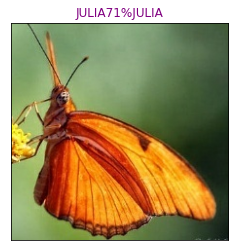

In [46]:
prediction_visual (prediction_probabilities=predictions, labels=val_labels, images =val_images)

In [49]:
# Function plots highest 10 prediction confidences and a true label for certain sample n
def plot_confid (prediction_probabilities, labels, n=1):
  
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Getting label of prediction
  pred_label = get_label_predicted(pred_prob)

  # Get 10 hghest prediction indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Get  the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Getthe top 10 prediction labels
  top_10_pred_labels = unique_species [top_10_pred_indexes]

  #Create the plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # The color of true label is set to orange
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("orange")
  else:
    pass

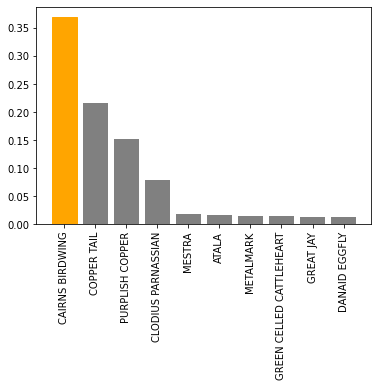

In [50]:
plot_confid(prediction_probabilities=predictions,
               labels=val_labels,
               n=35)

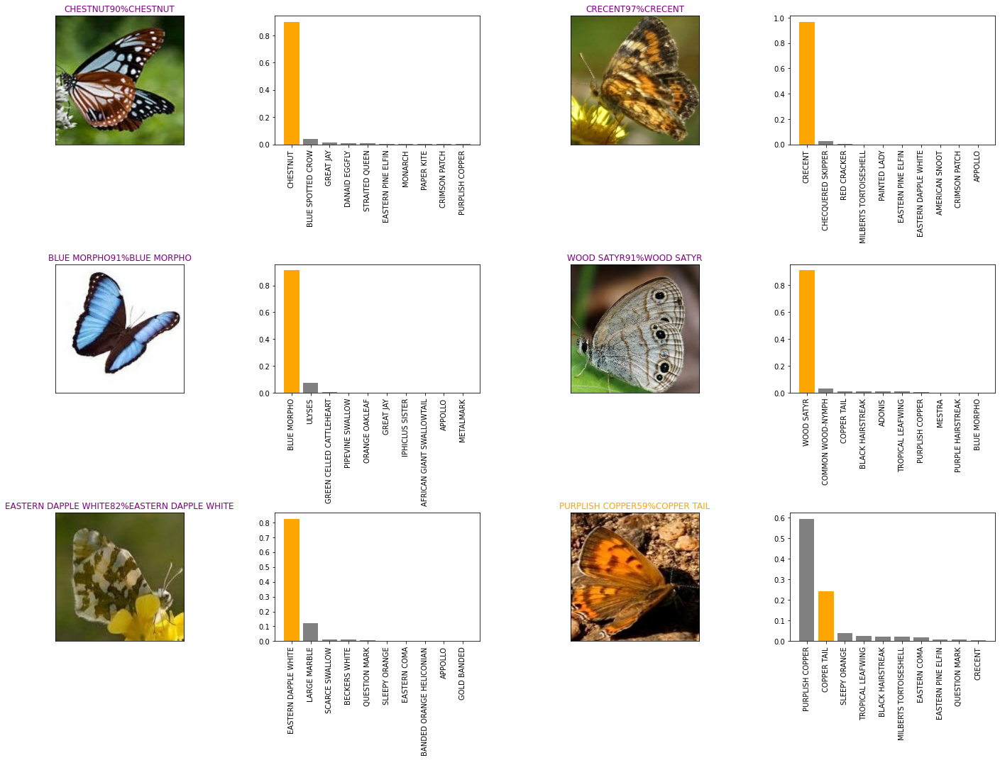

In [51]:
# Visualize confidences for several predictions
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  prediction_visual(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_confid (prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

In [58]:
#Function saves trained model into specified directory
def saved_model(model, suffix=None):
  
  modeldir = os.path.join("drive/MyDrive/Colab Notebooks/Butterfly_Classification/models",  datetime.datetime.now().strftime("%Y%m%d"))  
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [61]:
#Function to load model from a defined path
def load_model(model_path):
  
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [60]:
# Save our model trained on 2000 images
saved_model(model, suffix="small-model")

Saving model to: drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-small-model.h5...


'drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-small-model.h5'

In [62]:
#Load saved model using the path
model_2000_images = load_model('/content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-small-model.h5')

Loading saved model from: /content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-small-model.h5


In [65]:
#train with full data. Check the full data set
len(x), len(y)

(6499, 6499)

In [66]:
#Create batches for full data
full_data= turn_to_batch (x, y)

Turning training data to batches batches


In [67]:
full_model=my_model()

In [69]:
# Create tensorboard and early stopping callbacks for full data model
full_model_tensorboard = tensorboard_callback()
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy", patience=3)

In [71]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=50,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/50
186/186 [==============================] - 1122s 6s/step - loss: 1.5182 - accuracy: 0.6498
Epoch 2/50
186/186 [==============================] - 15s 82ms/step - loss: 0.4443 - accuracy: 0.8955
Epoch 3/50
186/186 [==============================] - 15s 82ms/step - loss: 0.2867 - accuracy: 0.9341
Epoch 4/50
186/186 [==============================] - 15s 82ms/step - loss: 0.2046 - accuracy: 0.9548
Epoch 5/50
186/186 [==============================] - 15s 82ms/step - loss: 0.1512 - accuracy: 0.9700
Epoch 6/50
186/186 [==============================] - 15s 81ms/step - loss: 0.1149 - accuracy: 0.9811
Epoch 7/50
186/186 [==============================] - 16s 88ms/step - loss: 0.0925 - accuracy: 0.9851
Epoch 8/50
186/186 [==============================] - 15s 81ms/step - loss: 0.0743 - accuracy: 0.9888
Epoch 9/50
186/186 [==============================] - 15s 82ms/step - loss: 0.0620 - accuracy: 0.9912
Epoch 10/50
186/186 [==============================] - 15s 81ms/step - loss: 0.052

In [72]:
# Save model to file
saved_model(full_model, suffix="full-model")

Saving model to: drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-full-model.h5...


'drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-full-model.h5'

In [74]:
#display tensorboard for full data model
%tensorboard --logdir /content/drive/MyDrive/Colab\ Notebooks/Butterfly_Classification/logs2

Reusing TensorBoard on port 6006 (pid 739), started 1:02:17 ago. (Use '!kill 739' to kill it.)

<IPython.core.display.Javascript object>

In [75]:
# Load in the full model
loaded_full_model = load_model('/content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-full-model.h5')

Loading saved model from: /content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/models/20221031-full-model.h5


In [77]:
#Making predictions on test data set
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterfly Identification/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]



In [78]:
#check number of test images
len(test_filenames)

2786

In [79]:
# Batch for test data
test_data = turn_to_batch (test_filenames, test_data=True)

Turning test data to batch...


In [80]:
# use full data model for predictions on test batches
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

80/80 [==============================] - 42s 81ms/step


In [81]:
# Check test predictions
test_predictions[:10]

array([[4.42354420e-08, 2.98435339e-11, 2.37819937e-15, 2.88112394e-12,
        3.36137829e-13, 3.92004068e-10, 5.18844551e-11, 5.76229515e-12,
        5.74079033e-13, 1.24456265e-10, 9.28726678e-08, 3.46108875e-09,
        1.01327502e-09, 4.59006360e-16, 1.45263677e-14, 7.05840822e-14,
        1.21487279e-13, 1.93864708e-15, 7.19751271e-14, 2.69623225e-14,
        3.76413614e-12, 3.45825885e-12, 4.59515181e-09, 6.53090595e-08,
        6.53211721e-11, 2.20987673e-09, 1.61182667e-12, 1.52378099e-12,
        8.52300956e-12, 7.51133617e-12, 1.89867458e-12, 5.27950625e-08,
        1.32424205e-09, 1.28757497e-12, 6.76798548e-12, 2.22417889e-08,
        1.01467370e-12, 7.39076989e-15, 2.97391065e-14, 5.28180396e-15,
        7.31797956e-12, 2.02462396e-12, 6.36349376e-11, 1.68094094e-10,
        3.33122673e-17, 4.21965723e-07, 7.45689927e-14, 1.35727334e-12,
        6.14773787e-09, 7.90166120e-15, 2.33572774e-14, 7.29065197e-10,
        1.14136366e-16, 2.55565846e-11, 9.99999166e-01, 3.983790

In [82]:
#Get predictions labels for test data
test_pred_labels = [get_label_predicted(test_predictions[i])for i in range (len(test_predictions))]
test_pred_labels

['POPINJAY',
 'ZEBRA LONG WING',
 'SILVER SPOT SKIPPER',
 'ADONIS',
 'CRIMSON PATCH',
 'MILBERTS TORTOISESHELL',
 'GREAT JAY',
 'ATALA',
 'SOUTHERN DOGFACE',
 'AMERICAN SNOOT',
 'IPHICLUS SISTER',
 'PIPEVINE SWALLOW',
 'METALMARK',
 'MESTRA',
 'CLODIUS PARNASSIAN',
 'STRAITED QUEEN',
 'RED POSTMAN',
 'EASTERN COMA',
 'ADONIS',
 'BLUE MORPHO',
 'RED ADMIRAL',
 'COMMON WOOD-NYMPH',
 'WOOD SATYR',
 'ORCHARD SWALLOW',
 'AN 88',
 'STRAITED QUEEN',
 'COPPER TAIL',
 'SLEEPY ORANGE',
 'SOOTYWING',
 'ZEBRA LONG WING',
 'RED CRACKER',
 'CHECQUERED SKIPPER',
 'QUESTION MARK',
 'CHESTNUT',
 'CAIRNS BIRDWING',
 'CHECQUERED SKIPPER',
 'MALACHITE',
 'BLUE SPOTTED CROW',
 'INDRA SWALLOW',
 'RED SPOTTED PURPLE',
 'CHECQUERED SKIPPER',
 'CLOUDED SULPHUR',
 'GREY HAIRSTREAK',
 'VICEROY',
 'TROPICAL LEAFWING',
 'GREEN CELLED CATTLEHEART',
 'TROPICAL LEAFWING',
 'RED SPOTTED PURPLE',
 'GREEN CELLED CATTLEHEART',
 'EASTERN COMA',
 'CAIRNS BIRDWING',
 'BANDED PEACOCK',
 'MOURNING CLOAK',
 'ATALA',
 'GOLD BAN

In [88]:
#Unbatchify test images
test_images = []
for image in test_data.unbatch().as_numpy_iterator():
  test_images.append(image)

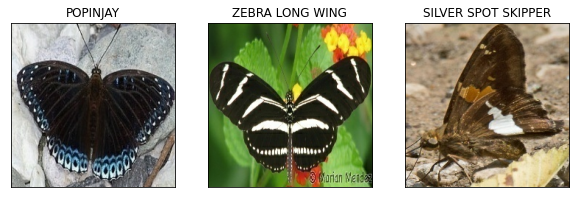

In [89]:
# Visualize some predictions
plt.figure(figsize = (10, 10))
for i, image in enumerate (test_images[:3]):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(test_pred_labels[i])
  plt.imshow(image)


In [91]:
#install gradio interface
!pip install -q gradio

In [96]:
#Define function for the interface 
from numpy.ma.extras import unique
import gradio as gr
import tensorflow as tf
import requests
import torch
import requests 
from PIL import Image
from torchvision import transforms

model = loaded_full_model


def predict_image (customer_image):
  customer_image = customer_image.reshape (1, 224, 224, 3),
  prediction_my = loaded_full_model.predict(customer_image),
  my_pred_labels = [get_label_predicted (prediction_my[i]) for i in range(len(prediction_my))]


  return {my_pred_labels[i]: (my_pred_labels[i]) for i in  range (len(prediction_my))}

In [97]:
# Run user interface 

demo = gr.Interface(fn=predict_image, 
             inputs=gr.Image (shape = ( 224, 224)),
             outputs = gr.Label(num_top_classes=3),
             title = 'Butterfly Classification',
             examples = ["/content/drive/MyDrive/Colab Notebooks/Butterfly_Classification/Butterflies/butterfly1.JPG"]).launch()
            

Colab notebook detected. To show errors in colab notebook, set `debug=True` in `launch()`
Running on public URL: https://41d6fbcd16627c25.gradio.app

This share link expires in 72 hours. For free permanent hosting and GPU upgrades (NEW!), check out Spaces: https://huggingface.co/spaces
